# Chapter 8: GeoPandas Python Library

## Managing, Analyzing and Visualizing Vector Data

**Author: Dr. Suborna Ahmed**

```{image} week11_img/geopandas1.png
:class: bg-primary mb-1
:width: 600px
:align: center
```

## <span style="color:blue"> Learning Objectives:</span>  

- **GeoPandas GeoDataFrame**
    - Advantages/disadvantages
    - Data checks and exploration
    - Spatial attributions and projecting
    - Interactive and static plotting

- **Spatial analysis**
    - Geometric manipulations
    - Set-Operations
    - Subsetting and (spatial) aggregation

- **Integration with Rasterio**

## 1. Set up Miniconda

### Usefull resources:
* Conda Cheatsheet: https://docs.conda.io/projects/conda/en/4.6.0/_downloads/52a95608c49671267e40c689e0bc00ca/conda-cheatsheet.pdf
* The geospatial package! Use Mamba to install... https://geospatial.gishub.org/installation/

### Geospatial packages used today:
* Geopandas
* Folium
* Rasterio
* Rasterstats

## 2. What is GeoPandas?

GeoPandas is a crucial and extensive library used in the field of geography and GIS (Geographical Information Systems).

### GeoSeries - the 'geometry' column
![geopandas2.png](week11_img/geopandas2.png)

### Just an extension to Pandas?

GeoPandas indeed builds on the capabilities of Pandas, but there's much more to it.

- GeoDataFrames look the same:

GeoDataFrames look similar to the conventional Pandas DataFrame, complete with rows and columns that can be manipulated using typical DataFrame operations.

- Fully integrates with Pandas' functions:

GeoPandas not only adopts the appearance of Pandas but also integrates fully with its functions. You can apply regular Pandas methods to GeoDataFrames

#### Differences with Pandas:
- A **GeoSeries** which stores geometries and CRS (Coordinate Reference System): Unlike a regular Pandas Series, a GeoSeries stores spatial objects and can include CRS information, defining how the coordinates relate to locations on the Earth's surface.
- **Exploring geospatial data**: With GeoPandas, quick visualizations of spatial data are possible, allowing a more intuitive understanding of geographic relationships.
- Most typical **GIS operations** available: From spatial joins to overlays, GeoPandas offers the tools to perform most common GIS operations, something beyond the capabilities of standard Pandas.

#### Advantages
- **Spatial indexing** - spatial selections are super fast
- The whole **Python data science stack** is available to you!!

#### Disadvantages
- Limited 3D Support: GeoPandas primarily focuses on 2D geometries. For applications requiring extensive 3D support, other specialized libraries might be more suitable.

### Geometric objects

GeoPandas represents geometry objects in text format. Note, it uses the package Shapely to interpret these objects.

Three main geometric object types:

![geometric.png](week11_img/geometric.png)

`````{admonition} The following example are geometric representations of a polygon and a multipolygon:
:class: important

**Coordinates**: The series of coordinate pairs inside the double parentheses define the vertices of the polygon.

**POLYGON**: indicates that the geometry is representing a polygon. A polygon is a two-dimensional shape with straight sides, often used in GIS and spatial analysis to define areas or regions.

**MULTIPOLYGON**: indicates that the geometry consists of multiple polygons. Each polygon is a collection of linear rings that form a closed loop. MULTIPOLYGONs are used to describe complex features consisting of several non-connected parts. (The MULTIPOLYGON below contains two separate polygons, each enclosed in double parentheses)

    
> 'POLYGON ((**-123.12439615721482 49.253389655118525**, -123.12216852657728 49.25334321506493, <br>
-123.12035729640567 49.25330538420304, -123.12038689523503 49.252491276653686, <br>
-123.12041649318077 49.25167719596781, -123.12222696366466 49.25171528756164, <br>
-123.12446759063558 49.25176233315163, -123.124431874511 49.25257599869532, <br>
**-123.12439615721482 49.253389655118525**))' <br>


> 'MULTIPOLYGON ((**-123.12439615721482 49.253389655118525**, -123.12216852657728 49.25334321506493, <br>
-123.12035729640567 49.25330538420304, -123.12038689523503 49.252491276653686, <br>
-123.12041649318077 49.25167719596781, -123.12222696366466 49.25171528756164, <br>
-123.12446759063558 49.25176233315163, -123.124431874511 49.25257599869532, <br>
**-123.12439615721482 49.253389655118525**)), <br>
((**-123.12439615721482 49.253389655118525**, -123.12216852657728 49.25334321506493,
-123.12035729640567 49.25330538420304, **-123.12439615721482 49.253389655118525**)))<br>
    
    
``````

## 3. Exploring GeoDataFrames

### Data sets

</br>

From City of Vancouver's Open Data Portal - https://opendata.vancouver.ca/

| Dataset      | Type | File name | Description |
| ----------- | ----------- |----------- | ----------- |
| Street trees | Points | street-trees.geojson | https://opendata.vancouver.ca/explore/dataset/street-trees/information/ |
| Parks   | Polygons | parks-polygon.geojson | https://opendata.vancouver.ca/explore/dataset/parks-polygon-representation/information/ |
| Local areas   | Polygons | local-area-boundary.geojson | https://opendata.vancouver.ca/explore/dataset/local-area-boundary/information/ |
| Disability Parking | Text | disability-parking.geojson | https://opendata.vancouver.ca/explore/dataset/disability-parking/information/ |


### Pandas functions

In [1]:
# pip install folium

import geopandas as gpd
import pandas as pd
import numpy as np
import folium
from folium import plugins 
import matplotlib.pyplot as plt

# Load all required spatial datasets

gpdTrees = gpd.read_file('week11_data/street-trees.geojson')
gpdParks = gpd.read_file('week11_data/parks-polygon.geojson')
gpdParking = gpd.read_file('week11_data/disability-parking.geojson') 
gpdAreas = gpd.read_file('week11_data/local-area-boundary.geojson') # local areas

# Many file formats are supported (https://geopandas.org/en/stable/docs/user_guide/io.html)
# - Shapefiles
# - Zipped Shapefiles
# - GeoPackage database files
# - KML / KMZ
# - NO ESRI geodatabases!!

KeyboardInterrupt: 

In [3]:
# Pandas methods for DataFrame exploration can be used!
gpdTrees.head()

,diameter,genus_name,common_name,cultivar_name,species_name,assigned,root_barrier,plant_area,curb,std_street,date_planted,on_street,tree_id,civic_number,neighbourhood_name,height_range_id,on_street_block,street_side_name,geometry
0,15.00,PRUNUS,KWANZAN FLOWERING CHERRY,KWANZAN,SERRULATA,N,N,7,Y,W 3RD AV,NaN,W 3RD AV,2504,1701,FAIRVIEW,3,1700,ODD,POINT (-123.14337 49.26891)
1,12.00,THUJA,PYRAMIDAL ARBORVITAE,PYRAMIDALIS,OCCIDENTALIS,N,N,B,Y,W 3RD AV,NaN,W 3RD AV,2505,1701,FAIRVIEW,3,1700,ODD,POINT (-123.14368 49.26892)
2,13.75,PRUNUS,KWANZAN FLOWERING CHERRY,KWANZAN,SERRULATA,N,N,7,Y,W 3RD AV,NaN,W 3RD AV,2517,1760,FAIRVIEW,3,1700,EVEN,POINT (-123.14449 49.26883)
3,15.00,PRUNUS,KWANZAN FLOWERING CHERRY,KWANZAN,SERRULATA,N,N,7,Y,W 3RD AV,NaN,W 3RD AV,2518,1760,FAIRVIEW,3,1700,EVEN,POINT (-123.14482 49.26884)
4,26.00,PRUNUS,KWANZAN FLOWERING CHERRY,KWANZAN,SERRULATA,N,N,6,Y,W 3RD AV,NaN,W 3RD AV,2522,1780,FAIRVIEW,3,1700,EVEN,POINT (-123.14515 49.26885)


In [4]:
# Let's check out the very powerful method '.info()'
gpdTrees.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 149930 entries, 0 to 149929
Data columns (total 19 columns):
 #   Column              Non-Null Count   Dtype   
---  ------              --------------   -----   
 0   diameter            149930 non-null  float64 
 1   genus_name          149930 non-null  object  
 2   common_name         149930 non-null  object  
 3   cultivar_name       79512 non-null   object  
 4   species_name        149930 non-null  object  
 5   assigned            149930 non-null  object  
 6   root_barrier        149930 non-null  object  
 7   plant_area          148447 non-null  object  
 8   curb                149930 non-null  object  
 9   std_street          149930 non-null  object  
 10  date_planted        67628 non-null   object  
 11  on_street           149930 non-null  object  
 12  tree_id             149930 non-null  object  
 13  civic_number        149930 non-null  object  
 14  neighbourhood_name  149930 non-null  object  
 15  height_ra

So there are 149930 street trees.

Missing data:
- 134199 records include geometry
- cultivar_name provided for 79512 records       
- date_planted provided for 67628 records

"A plant cultivar refers to a variation within a plant species that has been developed by a human horticulturist through controlled plant breeding, as opposed to occurring naturally"

In [5]:
# Output some basic stats
gpdTrees.describe()

,diameter,height_range_id
count,149930.000000,149930.000000
mean,11.935306,2.662149
std,9.210158,1.552271
min,0.000000,0.000000
25%,4.000000,1.000000
50%,9.500000,2.000000
75%,17.000000,4.000000
max,305.000000,10.000000


### Subsetting and Aggregating GeoDataFrames
Subsetting GeoDataFrames works exactly the same as with normal Pandas DataFrames!

The following example identifies and extracts the rows from a GeoPandas GeoDataFrame where the spatial geometry information (in the 'geometry' column) is missing, and display the last five rows.
<br>
`.isna()`: returns a Boolean Series, with True for every row where the 'geometry' value is `NaN (Not a Number) or NA (Not Available)`. In other words, it identifies rows where the spatial information is missing.

In [6]:
# We discovered entries without gemeometry, lets explore...
selection = gpdTrees.loc[gpdTrees['geometry'].isna()]
selection.tail()

,diameter,genus_name,common_name,cultivar_name,species_name,assigned,root_barrier,plant_area,curb,std_street,date_planted,on_street,tree_id,civic_number,neighbourhood_name,height_range_id,on_street_block,street_side_name,geometry
149919,4.0,CRATAEGUS,LAVALLEI HYBRID HAWTHORN,NaN,LAVALLEI X,N,N,4,Y,TRAFALGAR ST,NaN,TRAFALGAR ST,284870,2706,KITSILANO,1,2700,EVEN,None
149920,9.0,PRUNUS,RANCHO SARGENT CHERRY,RANCHO,SARGENTII,N,N,4,Y,TRAFALGAR ST,NaN,TRAFALGAR ST,284871,2706,KITSILANO,1,2700,EVEN,None
149921,6.0,CRATAEGUS,LAVALLEI HYBRID HAWTHORN,NaN,LAVALLEI X,N,N,4,Y,TRAFALGAR ST,NaN,TRAFALGAR ST,284872,2706,KITSILANO,1,2700,EVEN,None
149926,42.0,CEDRUS,DEODAR CEDAR,NaN,DEODARA,N,N,N,Y,VIVIAN DRIVE,NaN,VIVIAN DRIVE,285245,7906,KILLARNEY,7,7900,EVEN,None
149928,16.0,PRUNUS,JAPANESE FLOWERING CHERRY,NaN,SERRULATA,N,N,8,Y,E 11TH AV,NaN,E 11TH AV,285346,1457,KENSINGTON-CEDAR COTTAGE,4,1400,ODD,None


The example below first filters the data frame by Neighbourhood: gpdTrees['neighbourhood_name']=='DOWNTOWN' filters the rows in the GeoDataFrame where the 'neighbourhood_name' column has the value 'DOWNTOWN'. And gpdTrees['neighbourhood_name']=='WEST POINT GREY' filters the rows in the GeoDataFrame where the 'neighbourhood_name' column has the value 'WEST POINT GREY'.
<br>
After filtering the rows, loc[] is used to select the 'height_range_id' column for those filtered rows. 
<br>
The `.mode()` method calculates the mode of the 'height_range_id' values for the 'DOWNTOWN' neighborhood and 'WEST POINT GREY' neighborhood. The mode is the value that appears most frequently in a data set, so it gives you the most common height range in that neighborhood.

In [7]:
# Let's check tree height

print(gpdTrees.loc[gpdTrees['neighbourhood_name']=='DOWNTOWN', 'height_range_id'].mode())

print(gpdTrees.loc[gpdTrees['neighbourhood_name']=='WEST POINT GREY', 'height_range_id'].mode())

# Description 'height_range_id':
# values 0 - 10 for every 10 feet (e.g., 0 = 0-10 ft, 1 = 10-20 ft, 2 = 20-30 ft, ..., and 10 = 100+ ft)

0    2
Name: height_range_id, dtype: int64
0    1
Name: height_range_id, dtype: int64


**Also aggregation works the same!**

`df.groupby()` is the basic aggregation methods used to compute within group statistics.
<br>
<br>
Subsetting and aggregating GeoDataFrames are essential techniques for managing and analyzing geospatial data. 
<br>
Subsetting allows you to focus on specific parts of the data that meet certain criteria, while aggregation lets you summarize and understand patterns within the data. With aggregation, you can also calculate summary statistics for each group, such as mean, sum, count, etc.
<br>
These operations are powerful tools for data cleaning, exploration, and analysis, making them fundamental to working with geospatial data in GeoPandas.

![image](https://pandas.pydata.org/docs/_images/06_groupby_select_detail.svg)

Image from [https://pandas.pydata.org/](https://pandas.pydata.org/docs/getting_started/intro_tutorials/06_calculate_statistics.html)


This code below:
1. Groups the rows in the GeoDataFrame gpdTrees by the unique values in the 'neighbourhood_name' column. Essentially, it's segmenting the data by neighborhood, treating each distinct neighborhood as a separate group.

2. After grouping the data by neighborhood, selects the 'diameter' column.

3. Finally, .mean() calculates the mean (average) of the 'diameter' values within each neighborhood group. 

The result will be a pandas Series with the neighborhood names as the index and the mean diameters as the values.

In [8]:
gpdTrees.groupby('neighbourhood_name')['diameter'].mean()

neighbourhood_name
ARBUTUS-RIDGE               12.281992
DOWNTOWN                     8.063486
DUNBAR-SOUTHLANDS           14.677531
FAIRVIEW                    11.306774
GRANDVIEW-WOODLAND          12.788890
HASTINGS-SUNRISE            11.680582
KENSINGTON-CEDAR COTTAGE    11.957711
KERRISDALE                  12.790653
KILLARNEY                   10.104743
KITSILANO                   15.035828
MARPOLE                     11.728986
MOUNT PLEASANT              12.075201
OAKRIDGE                    10.376248
RENFREW-COLLINGWOOD          9.639552
RILEY PARK                  11.917149
SHAUGHNESSY                 14.817716
SOUTH CAMBIE                12.042835
STRATHCONA                  10.154407
SUNSET                      10.820122
VICTORIA-FRASERVIEW         10.394755
WEST END                    12.464704
WEST POINT GREY             13.539662
Name: diameter, dtype: float64

### Interactive mapping!
#### Create interactive map with two layers - polygons and points

In [9]:
# pip install folium matplotlib mapclassify

In [10]:
#### Generate an interactive leaflet map based on GeoDataFrame
# Learn more about .explore() # https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoDataFrame.explore.html

# First subsetting...

# 1. Remove records with NaN in 'geometry'
gpdTrees2 = gpdTrees.dropna(subset='geometry') 
# Learn more about functions like '.dropna()' here:
    # https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.dropna.html

# 2. Remove Stanley Park
gpdParks2 = gpdParks.loc[gpdParks['park_name']!='Stanley Park', :]
# Learn more about .loc and .iloc here:
    # https://pandas.pydata.org/docs/getting_started/intro_tutorials/03_subset_data.html

Here, the code below creates an interactive leaflet map "m" using the explore method. The parks are colored based on the 'area_ha' column, using the "viridis" colormap. Since categorical=False, the coloring is continuous rather than discrete.
<br>
<br>
Then the code filters gpdTrees2 to only include rows where the 'common_name' column contains 'CHERRY'. Then it adds these cherry trees as another layer to the existing map m, setting specific styling properties.

In [11]:
# 3. Add Parks layer... We can color by variable, such as area, creating a choropleth 
m = gpdParks2.explore(column="area_ha", 
                      categorical=False,
                      cmap="viridis")

cherryTrees = gpdTrees2.loc[gpdTrees2['common_name'].str.contains('CHERRY'),: ]

#. 4 Add another layer to mapping object
cherryTrees.explore(m=m, 
                  popup=False, 
                  style_kwds={'stroke':False, 
                              'fillOpacity':0.1, 
                              'fillColor':'forestgreen'})

# 5. Display in Jupyter
m

#### Create interactive map with two layers - polygons and heatmap!

1. Prepare Data for Heatmap:

The code takes the 'geometry' column from the cherryTrees GeoDataFrame and converts it into a list of points. Each point is represented by a pair of coordinates [latitude, longitude]. The xy attribute is used to extract the coordinates from the geometry. And the result is stored in heat_data.

In [12]:
# 1. Heatmap plugin needs data as list of points
heat_data = [[point.xy[1][0], point.xy[0][0]] for point in cherryTrees.geometry]
print("Converted data looks like;",heat_data[0:5])

Converted data looks like; [[49.268914, -123.143371], [49.268833, -123.14449], [49.268838, -123.144817], [49.268846, -123.145148], [49.268684, -123.155204]]


This line below creates an interactive map with a choropleth layer, where parks (gpdParks2) are colored based on the "area_ha" column using the "viridis" colormap. The map object is stored in the variable "m".
<br>
Then, using the HeatMap plugin, a heatmap layer is added to the existing map m.

In [13]:
# 2. Create Parks layer... We can color by variable, such as area, creating a choropleth 
m = gpdParks2.explore(column="area_ha", popup=False, categorical=False, cmap="viridis") #, tiles="Cartodb dark_matter")

# 3. Add Heatmap layer to Folium object
plugins.HeatMap(data=heat_data, radius=7.5).add_to(m)

# 4. Display in Jupyter
m

## 4. Spatial attributes of GeoDataFrames

### Build-in attributes

**A Coordinate Reference System (CRS) can be either `geographic` or `projected`.**

- **Geographic** CRS: This type of CRS uses a `three-dimensional` spherical surface to define locations on the earth. The coordinates are often latitude and longitude, and the CRS usually refers to a specific datum. An example of a geographic CRS is WGS 84, often represented by the EPSG code 4326.

- **Projected** CRS: A projected CRS, on the other hand, provides a flat, `two-dimensional` surface. It uses mathematical formulas to project the geographic coordinates (latitude and longitude) onto a flat surface. The units in a projected CRS are often meters or feet.

**Is the dataset projected?**

In GeoPandas, the `.crs` attribute stores this information for a GeoDataFrame. By running gpdParks.crs, you're asking to see what CRS is being used for the gpdParks GeoDataFrame. 

In [14]:
gpdParks.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- undefined
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

**What is the extent of the dataset?**

The "extent" of a spatial dataset refers to the bounding box that encloses all the features in the dataset. It is usually represented by four values: the `minimum x-coordinate` (longitude), the `minimum y-coordinate` (latitude), the `maximum x-coordinate` (longitude), and the `maximum y-coordinate` (latitude).

In [15]:
extent = gpdParks.total_bounds
print(extent[0], "Minimum longitude (west-most coordinate)")
print(extent[1], "Minimum latitude (south-most coordinate)")
print(extent[2], "Maximum longitude (east-most coordinate)")
print(extent[3], "Maximum latitude (north-most coordinate)")

-123.23712638272673 Minimum longitude (west-most coordinate)
49.2001251859493 Minimum latitude (south-most coordinate)
-123.02376165499146 Maximum longitude (east-most coordinate)
49.31410394155363 Maximum latitude (north-most coordinate)


**What is the geometry type of each object?**

To find out the geometry type of each object in a GeoDataFrame, you can use the `.geom_type` attribute.

In [16]:
gpdAreas.geom_type.head()

0    Polygon
1    Polygon
2    Polygon
3    Polygon
4    Polygon
dtype: object

### Calculations using geometries

Use `geopandas.GeoSeries.area` for polygons or `geopandas.GeoSeries.length` for lines


The code below will display the calculated area for the first five polygons (parks) in the gpdParks GeoDataFrame.

**Do the results make sense?**

In [17]:
gpdParks.area.head()

/var/folders/qt/qy37fy6s3c1553y2k74063pr0000gn/T/ipykernel_19246/1320123648.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gpdParks.area.head()


0    6.589761e-06
1    1.273314e-07
2    3.771157e-06
3    5.309702e-06
4    4.269486e-06
dtype: float64

### Projections

### Projecting a GeoDataFrame

The Geographic projection was WGS84, with no projected coordinate system specified.
Lets convert to a UTM projection, which as meters as units.
<br>
<br>
`Universal Transverse Mercator (UTM)` is a popular choice for projecting geographic coordinates into a flat (planar) coordinate system that uses meters as units. UTM is more suitable for distance and area calculations as compared to geographic coordinate systems like WGS84, which uses degrees.

In [18]:
# 1. Project
crs = 'EPSG:32610' # Replace with the correct EPSG code for your UTM zone
gpdParksUtm = gpdParks.to_crs(crs) # Convert the GeoDataFrame to the UTM projection
gpdParksUtm.crs

<Projected CRS: EPSG:32610>
Name: WGS 84 / UTM zone 10N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 126°W and 120°W, northern hemisphere between equator and 84°N, onshore and offshore. Canada - British Columbia (BC); Northwest Territories (NWT); Nunavut; Yukon. United States (USA) - Alaska (AK).
- bounds: (-126.0, 0.0, -120.0, 84.0)
Coordinate Operation:
- name: UTM zone 10N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [19]:
# 2. Calculate areas again
gpdParksUtm['area_sqm'] = gpdParksUtm.area  
gpdParksUtm['area_ha_2'] = gpdParksUtm['area_sqm'] / 10000 # Devide by 10,000 to convert sqm to ha

In [20]:
# 3. Check.. New values similar as found in the original df?
gpdParksUtm.loc[:, ['area_ha','area_ha_2']].head()

,area_ha,area_ha_2
0,5.331178,5.331178
1,0.102943,0.102943
2,3.049800,3.049800
3,4.295203,4.295203
4,3.454305,3.454305


In [21]:
# Lets do this for all datasets
gpdTreesUtm = gpdTrees.to_crs(crs)
gpdParkingUtm = gpdParking.to_crs(crs)
gpdAreasUtm = gpdAreas.to_crs(crs)

## 5. Geometric manipulations

Many build-in functions can construct new geometries for existing geometries....

| Method      | Syntax | Description |
| :----------- | :----------- | :----------- | 
| Buffer | GeoSeries.buffer(distance, resolution=16) | Buffer | 
| Boundary | GeoSeries.boundary | Returns the outer boundary of each geometry in a GeoSeries | 
| Centroid | GeoSeries.centroid | Returns a centroid for each geometry in a GeoSeries | 
| Envelope | GeoSeries.simplify(tolerance, preserve_topology=True) | Returns the smallest possible rectangular polygon for each geometry in a GeoSeries | 
| Simplify | GeoSeries.simplify(tolerance, preserve_topology=True) | Returns a simplified geometry for each geometry in a GeoSeries | 
| Unary union | GeoSeries.unary_union | Peforms an union operation based on all geometries in a GeoSeries |

https://geopandas.org/en/stable/docs/user_guide/geometric_manipulations.html#geometric-manipulations

This code below filters gpdParksUtm to only include the rows for three specific parks: 'Stanley Park', 'Devonian Harbour Park', 'English Bay Beach Park', and assigns the resulting subset to a new GeoDataFrame named 'test'.

In [22]:
# Subset some parks for testing geometric manipulations
test = gpdParksUtm.loc[gpdParksUtm['park_name'].isin(['Stanley Park', 
                                                      'Devonian Harbour Park', 
                                                      'English Bay Beach Park']), :]
test.head()

,area_ha,park_url,park_name,park_id,geometry,area_sqm,area_ha_2
9,4.436331,http://covapp.vancouver.ca/parkfinder/parkdeta...,Devonian Harbour Park,18.0,"POLYGON ((490166.925 5460125.691, 490081.298 5...",4.436331e+04,4.436331
81,9.972022,http://covapp.vancouver.ca/parkfinder/parkdeta...,English Bay Beach Park,201.0,"POLYGON ((489404.304 5459736.711, 489605.265 5...",9.972022e+04,9.972022
246,417.949257,http://covapp.vancouver.ca/parkfinder/parkdeta...,Stanley Park,206.0,"POLYGON ((489726.057 5462383.588, 489727.344 5...",4.179493e+06,417.949256


1. Buffer
<br>
This code buffers geometries by 100 meters, and then creates a plot of the resulting geometries with specific formatting for the axis labels.

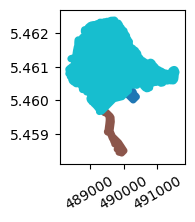

In [23]:
# 1. Buffer
buffer = test.copy() # deep copy
# buffer operation is applied to the 'geometry' column 
buffer['geometry'] = buffer.buffer(distance=100) # 100 m buffer

# column='park_name' argument specifies that the colors of the geometries should be determined by the values in the 'park_name' column
p = buffer.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels by 30 degrees to make the labels more readable

2. Boundary
<br>
This code extracts their boundaries, and then creates a plot of the resulting boundary geometries with specific formatting for the axis labels. The final plot will display only the boundaries of the selected geometries, without their interior fill.

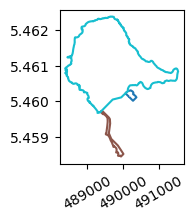

In [24]:
# 2. Boundary
boundary = test.copy() # deep copy
boundary['geometry'] = boundary['geometry'].boundary # Get boundary

p = boundary.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

3. Centroid
<BR>
This code calculates their centroids, and then creates a plot of the resulting centroid points with specific formatting for the axis labels. The final plot will display only the centroids of the selected geometries, allowing you to visualize the geometric centers of these shapes.

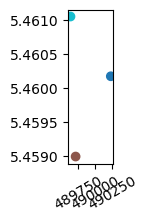

In [25]:
# 3. Centroid
centroid = test.copy() # deep copy
centroid['geometry'] = centroid['geometry'].centroid # Get centroid

p = centroid.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

4. Envelope
<br>
This code calculates their bounding envelopes, and then creates a plot of the resulting envelope geometries with specific formatting for the axis labels. The final plot will display only the envelopes of the selected geometries, allowing you to visualize the minimal rectangular bounding areas of these shapes.

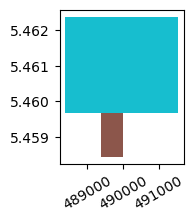

In [26]:
# 4. Envelope
envelope = test.copy() # deep copy
envelope['geometry'] = envelope['geometry'].envelope # Get Envelops

p = envelope.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

5. Simplify
<br>
This code simplifies the geometries using a specified tolerance and then plots the resulting geometries. This simplification can be useful for reducing the size of a dataset or for visualizations where fine details are not required.

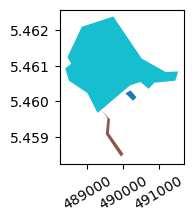

In [27]:
# 5. Simplify
simplify = test.copy() # deep copy
simplify['geometry'] = simplify.simplify(tolerance=100) # Simplify geometry using 100 m steps

p = simplify.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

6. Convex hull
<br>
This code plots the resulting convex hulls. The final plot will display the shapes of the convex hulls, providing a visual representation of the "enveloping" effect of the convex hull calculation. Convex hulls can be useful for understanding the spatial extent and distribution of complex geometries.

**A convex hull is the smallest convex polygon that encompasses all points in the geometry. Essentially, it creates a "rubber band" around the outermost points of each geometry.**

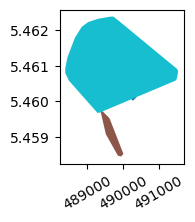

In [28]:
# 6. Convex hull
convex_hull = test.copy() # deep copy
convex_hull['geometry'] = convex_hull.convex_hull

p = convex_hull.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

7. Unary union
<br>
This code plots the resulting unary union. The unary union combines all individual geometries into one single geometry object, and the final plot will display this single unified geometry. Unary unions can be useful for simplifying complex spatial data and working with a unified representation of multiple geometries.

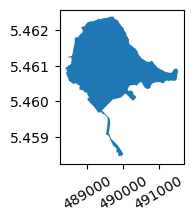

In [29]:
# 7. Unary union
unary_union = test.copy().reset_index() # deep copy
unary_union.loc[0,'geometry'] = unary_union.unary_union # new geometry in first row
unary_union.loc[1,'geometry'] = np.nan # second row... set to NaN
unary_union.loc[2,'geometry'] = np.nan # third row... set to NaN

p = unary_union.plot(figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

8. Rotate
<br>
This code rotates the geometries by 45 degrees and then plots the resulting rotated geometries. Geometric rotation can be useful for aligning geometries, comparing shapes at different orientations, or performing geometric analyses that require a specific orientation.

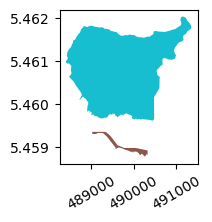

In [30]:
# 8. Rotate
# For more affine transformations...
    # https://geopandas.org/en/stable/docs/user_guide/geometric_manipulations.html#affine-transformations
rotate = test.copy() # deep copy
rotate['geometry'] = rotate.rotate(angle=45)

p = rotate.plot(column='park_name', figsize=(2,2))
p.yaxis.get_offset_text().set_visible(False) # Remove scientific notation
p.tick_params(axis='x', labelrotation=30) # Rotate labels

The code visualizes the geometric manipulations of park geometries we have talked above side by side.

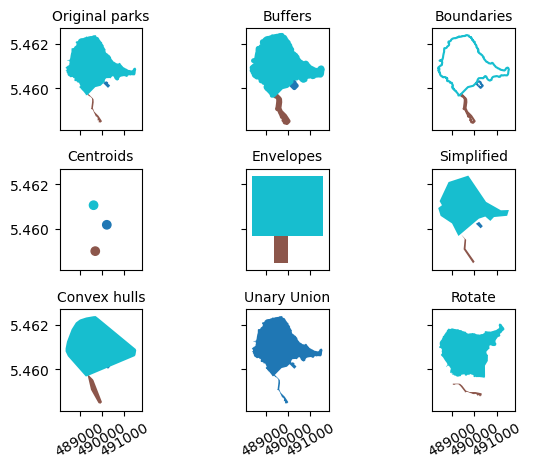

In [31]:
fig, axs = plt.subplots(3, 3, sharex=True, sharey=True)

test.plot(column='park_name', ax=axs[0,0], legend=False) # Plot
axs[0,0].set_title("Original parks", fontsize=10)  # Subplot title
axs[0,0].yaxis.get_offset_text().set_visible(False) # Remove scientific notation

buffer.plot(column='park_name', ax=axs[0,1], legend=False)
axs[0,1].set_title("Buffers", fontsize=10) 

boundary.plot(column='park_name', ax=axs[0,2], legend=False)
axs[0,2].set_title("Boundaries", fontsize=10) 

centroid.plot(column='park_name', ax=axs[1,0], legend=False)
axs[1,0].set_title("Centroids", fontsize=10) 
axs[1,0].yaxis.get_offset_text().set_visible(False) # Remove scientific notation

envelope.plot(column='park_name', ax=axs[1,1], legend=False)
axs[1,1].set_title("Envelopes", fontsize=10) 

simplify.plot(column='park_name', ax=axs[1,2], legend=False)
axs[1,2].set_title("Simplified", fontsize=10) 

convex_hull.plot(column='park_name', ax=axs[2,0], legend=False)
axs[2,0].set_title("Convex hulls", fontsize=10) 
axs[2,0].yaxis.get_offset_text().set_visible(False) # Remove scientific notation
axs[2,0].tick_params(axis='x', labelrotation=30) # Rotate x-axis labels

unary_union.plot(ax=axs[2,1], legend=False)
axs[2,1].set_title("Unary Union", fontsize=10) 
axs[2,1].tick_params(axis='x', labelrotation=30) # Rotate x-axis labels 

rotate.plot(column='park_name', ax=axs[2,2], legend=False)
axs[2,2].set_title("Rotate", fontsize=10) 
axs[2,2].tick_params(axis='x', labelrotation=30) # Rotate x-axis labels

fig.tight_layout() # Tighten layout


## 6. Set Operations

Set operators are used for creating new shapes using relationships between two or more different spatial datasets.

![set_op.png](week11_img/set_op.png)

### Intersection

#### Can we identify how many "Accessible parking" spaces each park has within 110 meters using this dataset?

Let's do the following together
1. Create 110 m buffers around parks
2. Perform an intersection between the Buffered parked and "Accessible parking" spaces.

In [32]:
# 1. Create 110 m buffers around parks
buffer = gpdParksUtm.copy()
buffer['geometry'] = gpdParksUtm.buffer(distance=110) # 110 meters

In [33]:
# 2. Perform an intersection between Buffered Parks and Street trees.
intersect = gpdParkingUtm.overlay(buffer, how='intersection')

In [34]:
# 3. Inspect output 
# Plot Parking all
m = gpdParkingUtm.explore(color='black')
# Plot parking intersecting with parks
intersect.explore(m=m)

In [35]:
# 3. Inspect output 
print("Columns Parks Buffers:", buffer.columns.tolist(), '\n')
print("Columns Parking Spaces:", gpdParkingUtm.columns.tolist(), '\n')
print("Columns intersect result:", intersect.columns.tolist(), '\n')

Columns Parks Buffers: ['area_ha', 'park_url', 'park_name', 'park_id', 'geometry', 'area_sqm', 'area_ha_2'] 

Columns Parking Spaces: ['location', 'spaces', 'geo_local_area', 'description', 'notes', 'geometry'] 

Columns intersect result: ['location', 'spaces', 'geo_local_area', 'description', 'notes', 'area_ha', 'park_url', 'park_name', 'park_id', 'area_sqm', 'area_ha_2', 'geometry'] 



Aggregation: Get parking spot count by park

In [36]:
# We can perform a typical aggregation using groupby !
spot_count = intersect.groupby('park_name', as_index=False)['location'].count()
spot_count = spot_count.rename(columns={'location':'spot_count'}) # rename column for convenience

spot_count.head(8)

,park_name,spot_count
0,5th and Pine,1
1,6th and Fir,1
2,Alexandra Park,1
3,Andy Livingstone Park,1
4,CRAB Park at Portside,1
5,Cathedral Square,1
6,Clark Park,1
7,Creekside Park,2


#### Which parks do not have a parking spot at all?

I would solve this using a left join... However, there could be other options to do this.

`````{admonition} pd.merge()
:class: tip
    
The `pd.merge` function helps merge two data frames together, and the argument `how` controls which values from the key column(s) appear in the output.

![merge.png](week11_img/merge.png)

``````

- left=gpdParksUtm: The gpdParksUtm dataframe is specified as the left dataframe in the merge operation.

- right=spot_count: The spot_count dataframe is specified as the right dataframe in the merge operation.

- on='park_name': The merge operation is performed based on the park_name column, which present in both dataframes. This means the values in this column are used to match the rows in both dataframes.

- how='left': This specifies that a left join is to be performed. 

**In a left join, all the rows from the left dataframe (gpdParksUtm) will be included in the result, and for those rows where there is no matching value in the right dataframe (spot_count), NaN values will be filled in for the missing columns.**

In [37]:
# 1. Left join... New parking spot count data on the Parks GeoDataFrame
gpdParksUtm2 = pd.merge(left=gpdParksUtm, 
         right=spot_count,
         on='park_name',
         how='left')

gpdParksUtm2.head()

,area_ha,park_url,park_name,park_id,geometry,area_sqm,area_ha_2,spot_count
0,5.331178,http://covapp.vancouver.ca/parkfinder/parkdeta...,Douglas Park,175.0,"POLYGON ((490947.597 5455631.973, 491109.695 5...",53311.775989,5.331178,NaN
1,0.102943,http://covapp.vancouver.ca/parkfinder/parkdeta...,Art Phillips Park,19.0,"POLYGON ((491262.910 5459236.000, 491238.957 5...",1029.434088,0.102943,NaN
2,3.049800,http://covapp.vancouver.ca/parkfinder/parkdeta...,Clinton Park,70.0,"POLYGON ((496222.737 5457613.705, 496393.636 5...",30497.999105,3.049800,NaN
3,4.295203,http://covapp.vancouver.ca/parkfinder/parkdeta...,Clark Park,81.0,"POLYGON ((494905.046 5456101.749, 494903.250 5...",42952.026153,4.295203,1.0
4,3.454305,http://covapp.vancouver.ca/parkfinder/parkdeta...,Chaldecott Park,37.0,"POLYGON ((485919.840 5455255.847, 486100.843 5...",34543.049621,3.454305,NaN


NaN values in the spot_count column are treated as 0's, indicating that there are no parking spots for those particular records.

In [38]:
# NaNs in 'spot_count' column are 0 parking spots
gpdParksUtm2['spot_count'] = gpdParksUtm2['spot_count'].fillna(0)

gpdParksUtm2.head()

,area_ha,park_url,park_name,park_id,geometry,area_sqm,area_ha_2,spot_count
0,5.331178,http://covapp.vancouver.ca/parkfinder/parkdeta...,Douglas Park,175.0,"POLYGON ((490947.597 5455631.973, 491109.695 5...",53311.775989,5.331178,0.0
1,0.102943,http://covapp.vancouver.ca/parkfinder/parkdeta...,Art Phillips Park,19.0,"POLYGON ((491262.910 5459236.000, 491238.957 5...",1029.434088,0.102943,0.0
2,3.049800,http://covapp.vancouver.ca/parkfinder/parkdeta...,Clinton Park,70.0,"POLYGON ((496222.737 5457613.705, 496393.636 5...",30497.999105,3.049800,0.0
3,4.295203,http://covapp.vancouver.ca/parkfinder/parkdeta...,Clark Park,81.0,"POLYGON ((494905.046 5456101.749, 494903.250 5...",42952.026153,4.295203,1.0
4,3.454305,http://covapp.vancouver.ca/parkfinder/parkdeta...,Chaldecott Park,37.0,"POLYGON ((485919.840 5455255.847, 486100.843 5...",34543.049621,3.454305,0.0


Now a map would be very useful!

## 7. Spatial Joins

Attributes of GeoDataFrame 'A' are 'joined' to GeoDataFrame 'B' for intersecting geometries. 

- Left joins: Keeps all rows in the left DataFrame.
- Right joins: Keeps all rows in the left DataFrame.
- Inner joins: Only keeps intersecting geometries. **Similar to the intersection in sets operation**

![merge2.png](week11_img/merge2.png)

Imagine, you are an **arborist** at **Vancouver's City and Park Board** and responsable for maintanance of trees in **Dunbar-Southlands**. It is probably useful to know:
* **HOW MANY** trees you need to maintain...
* **WHERE** they are...
* **WHAT** species they are...

With which join operation(s) can you find the trees in Dunbar?
Can you provide the information listed?


In [39]:
# Plot parks
m = gpdParksUtm2.explore(column="spot_count", popup=False, categorical=True, cmap="Set1")

# Add another layer to mapping object
gpdParkingUtm.explore(m=m, popup=False, style_kwds={'stroke':False, 'fillOpacity':1, 'fillColor':'black'})

m

**Example left join:**
<br>
A left join means that all the rows from gpdTrees will be kept, and matching rows from DS will be added. If a tree is not in Dunbar-Southlands, the columns from DS will be filled with NaN.

In [40]:
# Example left join

DS = gpdAreas.loc[gpdAreas['name']=='Dunbar-Southlands']

leftJoin = gpdTrees.sjoin(DS, how='left')

print(leftJoin.loc[:,['common_name', 'mapid', 'name']].tail(5), '\n')

print('Records in DS:', len(DS))
print('Records in gpdTrees:', len(gpdTrees))
print('Records in leftJoin:', len(leftJoin))

                      common_name mapid name
149925          EUROPEAN HORNBEAM   NaN  NaN
149926               DEODAR CEDAR   NaN  NaN
149927             SHANTUNG MAPLE   NaN  NaN
149928  JAPANESE FLOWERING CHERRY   NaN  NaN
149929               PEAR SPECIES   NaN  NaN 

Records in DS: 1
Records in gpdTrees: 149930
Records in leftJoin: 149930


**Example right join:**
<br>
A right join means that all the rows from DS will be kept, and matching rows from gpdTrees will be added. If there's a row in DS that doesn't have a corresponding match in gpdTrees, the columns from gpdTrees will be filled with NaN values.

In [41]:
# Example right join

DS = gpdAreas.loc[gpdAreas['name']=='Dunbar-Southlands']

rightJoin = gpdTrees.sjoin(DS, how='right')

print(rightJoin.loc[:,['common_name', 'mapid', 'name']].tail(5), '\n')

print('Records in DS:', len(DS))
print('Records in gpdTrees:', len(gpdTrees))
print('Records in rightJoin:', len(rightJoin))

                      common_name mapid               name
10  CHERRY, PLUM OR PEACH SPECIES    DS  Dunbar-Southlands
10                 CRIMEAN LINDEN    DS  Dunbar-Southlands
10                      RED ALDER    DS  Dunbar-Southlands
10                   PISSARD PLUM    DS  Dunbar-Southlands
10       KWANZAN FLOWERING CHERRY    DS  Dunbar-Southlands 

Records in DS: 1
Records in gpdTrees: 149930
Records in rightJoin: 8351


**Example inner join:**
<br>
A inner join means that the result will only include rows where there is a match in both gpdTrees and DS.
<br>
Thus, the result will contain only the information about the trees located within the Dunbar-Southlands area.

In [42]:
# Example inner join

DS = gpdAreas.loc[gpdAreas['name']=='Dunbar-Southlands']

innerJoin = gpdTrees.sjoin(DS, how='inner')

print(innerJoin.loc[:,['common_name','mapid', 'name']].tail(5), '\n')

print('Records in DS:', len(DS))
print('Records in gpdTrees:', len(gpdTrees))
print('Records in innerJoin:', len(innerJoin))

                          common_name mapid               name
149792  CHERRY, PLUM OR PEACH SPECIES    DS  Dunbar-Southlands
149793                 CRIMEAN LINDEN    DS  Dunbar-Southlands
149835                      RED ALDER    DS  Dunbar-Southlands
149890                   PISSARD PLUM    DS  Dunbar-Southlands
149912       KWANZAN FLOWERING CHERRY    DS  Dunbar-Southlands 

Records in DS: 1
Records in gpdTrees: 149930
Records in innerJoin: 8351


**WHAT** species ...

The plot will provide a visual representation of the 10 most common tree species in the Dunbar-Southlands area.

<Axes: title={'center': 'Top 10 species'}, xlabel='common_name', ylabel='count'>

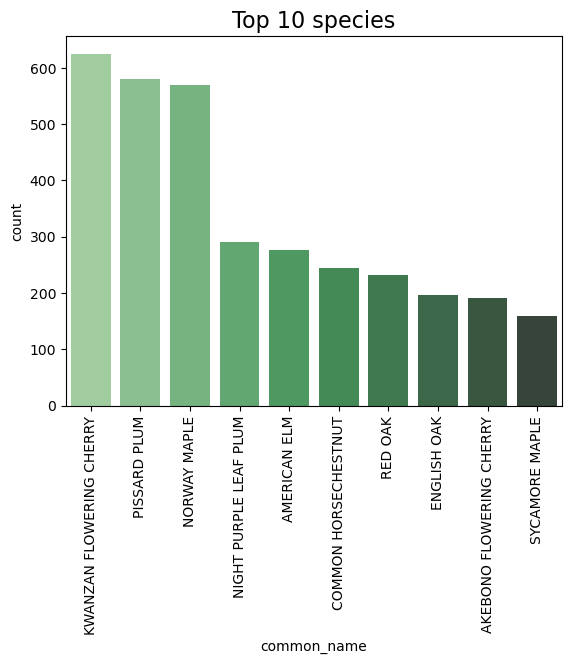

In [43]:
import seaborn as sns

# MOST COMMON SPECIES IN DUNBAR

p = sns.countplot(data=innerJoin, x='common_name', 
              order=innerJoin['common_name'].value_counts().iloc[:10].index, 
                  # only the top 10 most common species are plotted, ordered by their frequency.
              palette="Greens_d")
p.tick_params(axis='x', labelrotation=90) # Rotate labels
p.set_title('Top 10 species', fontsize=16) # Add title

p

In [44]:
# UNIQUE SPECIES IN DUNBAR

print('We have', 
      len(innerJoin['common_name'].unique()), 
      'unique species in Dunbar')

We have 344 unique species in Dunbar


In [45]:
# RARE SPECIES IN DUNBAR
# 1. tree count by species
groupbyCount = innerJoin.groupby('common_name')['diameter'].count()

# 2. subset less than 10 trees and get names (e.g. index)
countSubset = groupbyCount[groupbyCount < 10].index.tolist()

# 3. print results
print(len(countSubset))
print(countSubset)

219
['ALDER SPECIES', 'ALMIRA NORWAY MAPLE', 'AMERICAN BEECH', 'AMERICAN FILBERT', 'AMERICAN MOUNTAIN ASH', 'AMERICAN SWEETGUM', 'AMUR MAPLE', 'APPLE SERVICEBERRY', 'APPLE SPECIES', 'ARNOLD TULIPTREE', 'ASH SPECIES', 'ATLAS CEDAR', 'AUTUMN GOLD ASH', 'AUTUMN GOLD GINKGO', 'AUTUMN HIGAN CHERRY', 'AUTUMN SPLENDOR CHESTNUT', 'BAILEY SELECT CHOKECHERRY', 'BALSAM FIR', 'BASSWOOD', "BAUMANN'S SEEDLESS HORSECHESTN", 'BERGESON ASH', 'BIGLEAF LINDEN', 'BLACK CHERRY', 'BLACK COTTONWOOD', 'BLACK WALNUT', 'BLOODGOOD JAPANESE MAPLE', 'BLUE ATLAS CEDAR', 'BOXELDER', 'BRANDYWINE RED MAPLE', 'CAPITAL PEAR', 'CAUCASIAN MAPLE', 'CEDAR SPECIES', 'CHESTNUT OAK', 'CHESTNUT SPECIES', 'CHINA GIRL DOGWOOD', 'CHINESE KOUSA DOGWOOD', 'CHRISTINA COLUMNAR SPRUCE', 'COLUMNAR RED MAPLE', 'COLUMNAR SARGENT CHERRY', 'COMMON CATALPA', 'COMMON FIG', 'CORKSCREW WILLOW', 'CRIMSON SENTRY NORWAY MAPLE', 'CUTLEAF ENGLISH WALNUT', 'DAWN REDWOOD', 'DEBORAH NORWAY MAPLE', 'DOGWOOD SPECIES', 'DOVE OR HANDKERCHIEF TREE', 'EASTER

## 8. Aggregate geometries

Using **dissolve** we can aggregate geometries based on a common attribute.
<br>
In geospatial analysis, the term "dissolve" refers to the process of **aggregating geometries** based on a shared or common attribute. This process combines geometries that have the same value for a specified attribute into a single, new geometry. 
<br>
![aggregate.png](week11_img/aggregate.png)

Let's merge Vancouver's neighborhoods into three new large neigbhorhoods: North, Centre and South.

In [46]:
gpdAreas.explore()

The code given below is creating a lookup dictionary that maps different 'mapid' values to a corresponding 'section' value. Then pd.DataFrame.from_dict method is used to convert the dictionary into a pandas DataFrame (lookupDf).

In [47]:
# 1. Create a look-up dictionary
lookupDict = {'mapid':['WPG', 'KITS', 'FAIR', 'WE', 
                   'CBD', 'MP', 'STR', 'GW', 
                   'HS',
                   'DS', 'AR', 'SHAU', 'SC', 
                   'RP', 'KC', 'RC',
                   'KERR', 'OAK', 'MARP', 
                   'SUN', 'VF', 'KIL'],  
          
          'section':['north','north','north','north',
                     'north','north','north','north',
                     'north',
                     'mid','mid','mid','mid',
                     'mid','mid','mid',
                     'south','south','south',
                     'south','south','south']}

lookupDf = pd.DataFrame.from_dict(lookupDict, orient='columns') # Dictionary to DataFrame
lookupDf.head()

,mapid,section
0,WPG,north
1,KITS,north
2,FAIR,north
3,WE,north
4,CBD,north


The pd.merge function is used to join gpdAreas with lookupDf based on the 'mapid' column. A left join means that all rows from gpdAreas will be kept, and matching rows from lookupDf will be merged based on the 'mapid' column. This will add the 'section' column (from lookupDF) to the GeoDataFrame.
<br>
<br>
The dissolve method is applied to the merged GeoDataFrame based on the 'section' attribute. This will aggregate geometries that have the same 'section' value (e.g., 'north', 'mid', 'south'), and the attributes will be aggregated based on the first non-null value for each group.

In [48]:
# 2. Join attributes from Lookup DataFrame on GeoDataFrame
gpdAreasJoin = pd.merge(left=gpdAreas, 
                        right=lookupDf,
                        how='left',
                        on='mapid')  

# 3. Perform dissolve
gpdAreasJoin = gpdAreasJoin.dissolve(by='section')
gpdAreasJoin.head()

,geometry,mapid,name
section,,,
mid,"POLYGON ((-123.17870 49.23472, -123.17909 49.2...",AR,Arbutus-Ridge
north,"POLYGON ((-123.07758 49.25663, -123.07779 49.2...",CBD,Downtown
south,"POLYGON ((-123.11197 49.20446, -123.11240 49.2...",MARP,Marpole


In [49]:
m = gpdAreasJoin.explore()
m

## 9. Integration with Rasters


### Zonal statistics using vectors
* Also covers: creating a GeoDataFrame from raster boundary

The code reads a raster file and a vector file related to a specific geographic area.

In [50]:
import rasterio
from rasterio.plot import show

## Reading data
with rasterio.open(r"week11_data/DEM_25m.tif") as src:
    array = src.read(1, masked=True) #.astype('float32') # Reads the array using Rasterio. The raster has just one band, still we have to specify band number 1 in the .read() function.
    transform = src.transform

## Read Sample grids
# Zonal stats will be joined to this raster
ecoRegions = gpd.read_file("week11_data/Natural_Regions_Subregions_of_Alberta.gpkg")


The codes produce a plot displaying the raster data along with the vector boundaries overlaid on top. The raster is displayed as an image, while the vector data is drawn with red lines. It provides a visual representation of how the two datasets are spatially related.

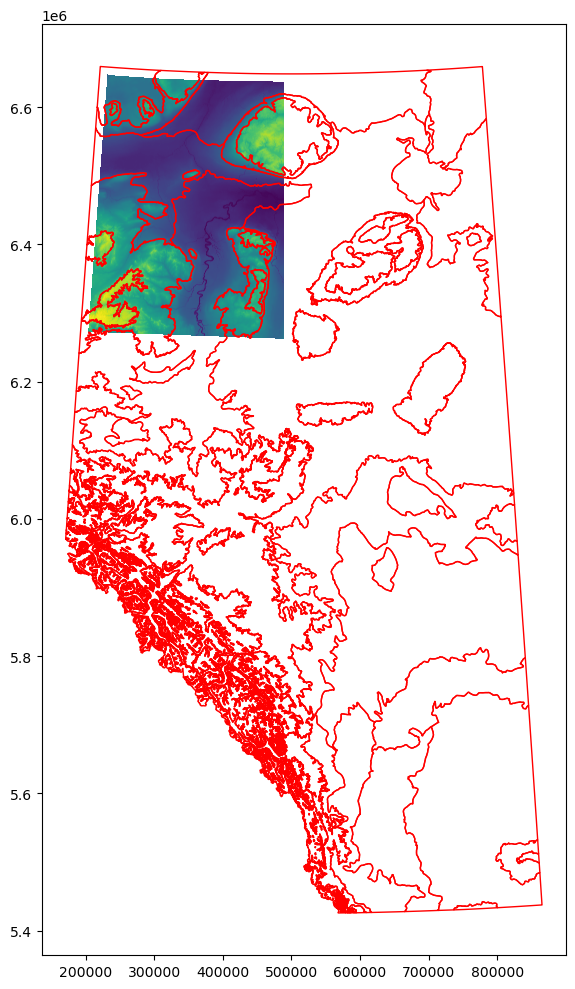

In [51]:
#  Visualizing raster and vector layers together 

# Initiate using pyplot.subplots
fig, ax = plt.subplots(figsize=(10, 10)) # Intiate matplotlib figure and axis object object

# Plot raster
im = rasterio.plot.show(array, transform=transform, ax=ax)

# Add vector data
ecoRegions.plot(ax=ax, facecolor='none', 
              edgecolor='red', linewidth=1, legend=True)

# Optimizes plot layout
fig.tight_layout() 

These codes read a DEM raster file, extracts its outline as a series of coordinate pairs, and prints the first five pairs from the last ring of the geometry. 

In [52]:
# Get outline of DEM raster

from rasterio.features import dataset_features

with rasterio.open(r"week11_data/DEM_25m.tif") as src:
    demCrs = src.crs
    shapes = list(dataset_features(src, 
                              bidx=1, # Band index
                              as_mask=True, # Load as boolean array
                              geographic=False,
                              band=False)) # Use the mask)

# Display output
# ...which contains a long list of coordinates...
shapes[0]['geometry']['coordinates'][-1][0:5] 

[(230882.94259999972, 6648075.486700058),
 (231432.94259999972, 6648075.486700058),
 (231432.94259999972, 6648050.486700058),
 (231782.94259999972, 6648050.486700058),
 (231782.94259999972, 6648025.486700058)]


The code below takes the coordinates (the coordinates of the last ring in the first geometry from a list of shapes), and converts it into a polygon object using the Shapely library.

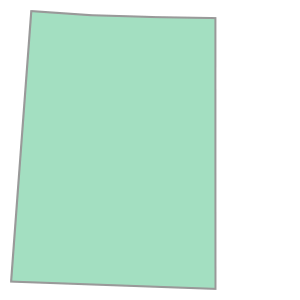

In [53]:
# Long list of coordinates... to Polygon

from shapely.geometry import Polygon

poly = Polygon(shapes[0]['geometry']['coordinates'][-1])

poly # display

The code demonstrates how to create a GeoDataFrame from a Shapely Polygon object.

In [54]:
# Polygon to GeoDataFrame

outlineDf = gpd.GeoDataFrame({'name': ['outline'], 'geometry':[poly]},
                             crs = demCrs)
outlineDf # Display

,name,geometry
0,outline,"POLYGON ((230882.94260 6648075.48670, 231432.9..."


The result of this code is a plot that visually represents the areas of the ecoRegions GeoDataFrame that intersect with the outlineDf.

/Users/luoyuwen/anaconda3/lib/python3.11/site-packages/geopandas/geodataframe.py:2361: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: EPSG:3400
Right CRS: LOCAL_CS["NAD_1983_10TM_AEP_Forest",UNIT["metre",1 ...

  return geopandas.clip(self, mask=mask, keep_geom_type=keep_geom_type)


<Axes: >

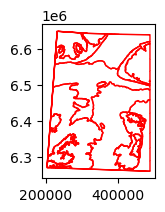

In [55]:
# Clip ecoRegions

ecoRegions = ecoRegions.clip(outlineDf)
ecoRegions.plot(figsize=(2,2), facecolor='none', 
              edgecolor='red', linewidth=1)

In [56]:
# pip install rasterstats

The code demonstrates how to compute zonal statistics using the zonal_stats function from the rasterstats library. 

In [57]:
# Using zonal_stats function from rasterstats

from rasterstats import zonal_stats

zs = zonal_stats(ecoRegions, r"week11_data/DEM_25m.tif", stats="mean std", prefix="dem_") 

zs = pd.DataFrame(zs)
zs.head() # display

,dem_mean,dem_std
0,407.454601,79.650899
1,859.205809,55.339362
2,596.399075,80.439971
3,362.485620,46.885253
4,785.814717,22.389663


The code concatenates the ecoRegions GeoDataFrame with the zs DataFrame, creating a new DataFrame ecoRegionsZs that includes both the spatial information from ecoRegions and the zonal statistics calculated earlier in zs.
<br>
The Pandas `.concat` function is used to concatenate the two DataFrames along axis=1 (combined side by side).

In [58]:
ecoRegionsZs = pd.concat([ecoRegions.reset_index(), zs], axis=1)
ecoRegionsZs.head()

,index,OBJECTID,NSRNAME,NSRCODE,NRNAME,Shape_STAr,Shape_STLe,geometry,dem_mean,dem_std
0,246,282,Central Mixedwood,CM,Boreal,1.624008e+11,1.160690e+07,"MULTIPOLYGON (((405678.794 6263709.301, 405694...",407.454601,79.650899
1,244,278,Boreal Subarctic,BSR,Boreal,9.525305e+09,7.227342e+05,"POLYGON ((487661.184 6511972.707, 487598.020 6...",859.205809,55.339362
2,261,300,Lower Boreal Highlands,LBH,Boreal,4.696318e+09,1.273875e+06,"MULTIPOLYGON (((487097.346 6497780.921, 486310...",596.399075,80.439971
3,278,317,Northern Mixedwood,NM,Boreal,2.380309e+10,1.164286e+06,"POLYGON ((487114.072 6619350.111, 486913.289 6...",362.485620,46.885253
4,358,401,Upper Boreal Highlands,UB,Boreal,9.258280e+08,2.534324e+05,"POLYGON ((448398.547 6362833.578, 448366.759 6...",785.814717,22.389663


### Rasterize GeoDataFrame

In [59]:
# 1. Open the raster file you want to use as a template 

with rasterio.open(r"week11_data/DEM_25m.tif") as src:
    profile = src.profile
    profile['compress']='lzw'

In [60]:
# 2. Now burn the features into the raster and write it out
from rasterio import features

with rasterio.open(r"week11_data/Ecoregions_25m.tif", 'w+', **profile) as dst:
    outArray = dst.read(1)

    # this is where we create a generator of geom, 
    # value pairs to use in rasterizing
    shapes = ((geom, value) for geom, value in zip(ecoRegions.geometry, ecoRegions.OBJECTID))

    burned = features.rasterize(shapes=shapes, fill=0, out=outArray, transform=dst.transform)
    
    dst.write_band(1, burned)

# Source of code: 
# https://gis.stackexchange.com/questions/151339/rasterize-a-shapefile-with-geopandas-or-fiona-python

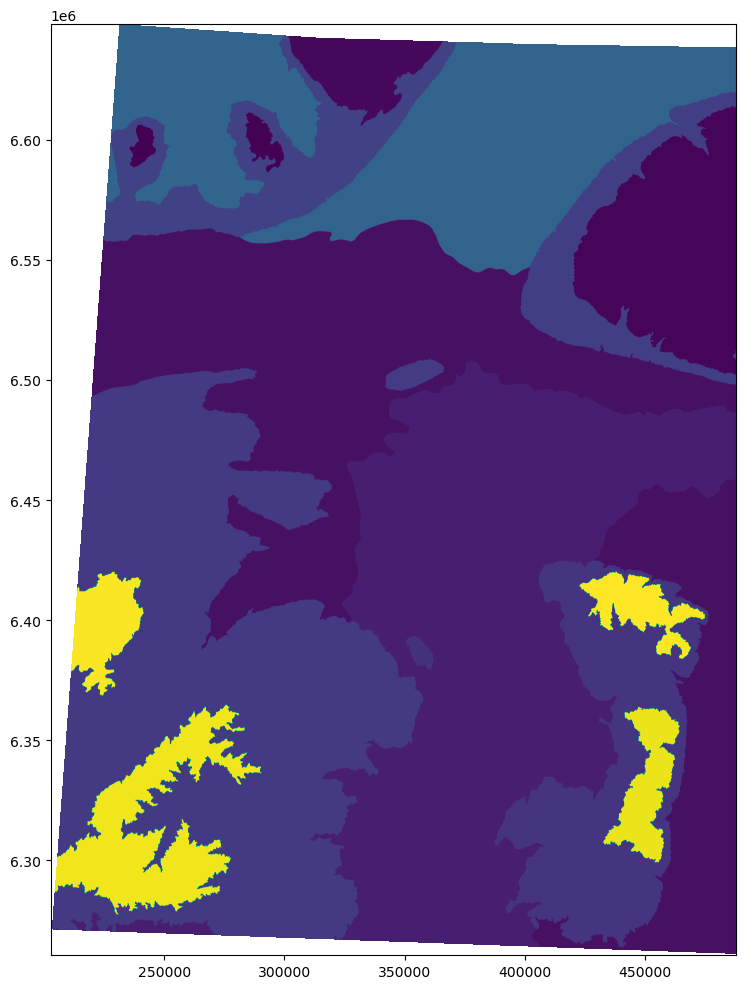

In [61]:
# 3. Load and visualize
with rasterio.open(r"week11_data/Ecoregions_25m.tif") as src:
    array = src.read(1, masked=True) # Reads the array using Rasterio. The raster has just one band, still we have to specify band number 1 in the .read() function.
    transform = src.transform

#  Visualizing raster
# Initiate using pyplot.subplots
fig, ax = plt.subplots(figsize=(10, 10)) # Intiate matplotlib figure and axis object object

# Plot raster
im = rasterio.plot.show(array, transform=transform, ax=ax)

# Optimizes plot layout
fig.tight_layout() 

### Clipping raster with geometry

In [62]:
# Use a geometry from GeoDataFrame for clipping a raster

# Example: 
    # 1. Select one of the ecoregions
    # 2. Use this to clip a DEM
    
ecoRegion = ecoRegions.loc[ecoRegions['NSRNAME']=='Central Mixedwood']

In [63]:
from rasterio import mask

with rasterio.open(r"week11_data/DEM_25m.tif") as src:
    profile = src.profile # Read dataset
    

    # Mask raster
    # First is a numpy array with null (-9999) values outside the geometry
    # Second output is an transformation matrix, to project local image coordinates to a georeference raster
    array, transform = rasterio.mask.mask(dataset=src,
                                         shapes=ecoRegion['geometry'],
                                         crop=True) 
    # Update metadata
    profile['width'] = array.shape[2]
    profile['height'] = array.shape[1]
    profile['transform'] = transform 
    
    # Write raster to disk
    with rasterio.open(r"week11_data/DEM_25m_clip.tif", 'w', **profile) as dst:
        dst.write(array)


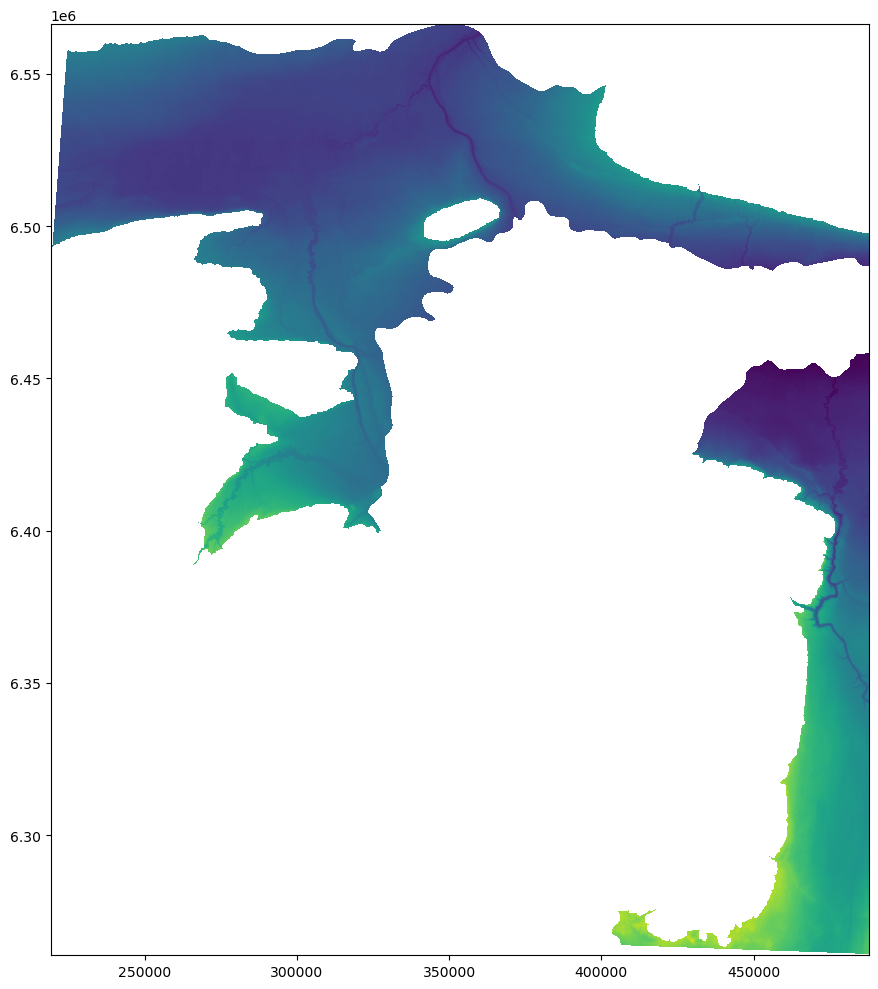

In [64]:
# 3. Load and visualize
with rasterio.open(r"week11_data/DEM_25m_clip.tif") as src:
    array = src.read(1, masked=True) # Reads the array using Rasterio. The raster has just one band, still we have to specify band number 1 in the .read() function.
    transform = src.transform

#  Visualizing raster
# Initiate using pyplot.subplots
fig, ax = plt.subplots(figsize=(10, 10)) # Intiate matplotlib figure and axis object object

# Plot raster
im = rasterio.plot.show(array, transform=transform, ax=ax)

# Optimizes plot layout
fig.tight_layout() 